<a href="https://colab.research.google.com/github/gulliiii/ObjectDetectionProject/blob/main/Soccer_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
iasadpanwhar_football_player_detection_yolov8_path = kagglehub.dataset_download('iasadpanwhar/football-player-detection-yolov8')

print('Data source import complete.')


# FOOTBALL PLAYER DETECTION with YOLO

### A notebook by Cametti Guglielmo

In this notebook, we will train a YOLO model with the goal of accurately identifying football players and footballs in images of football matches. Once the training is complete, we will analyze the results and share our observations.

## DATASET

The dataset includes 11.8k images with associated ground truth, divided into the following three sets:
* train: 10.3k images
* val:   972   images
* test:  520  images

Labels are annotated in YOLOv8 format as

    [class_id][center_x][center_y][width][height]

with

    0: 'football'
    1: 'player'

The following pre-processing was applied to each image:
* Auto-orientation of pixel data (with EXIF-orientation stripping)
* Resize to 1280x1280 (Stretch)

The following augmentation was applied to create 3 versions of each source image:
* 50% probability of horizontal flip
* Randomly crop between 0 and 25 percent of the image
* Random rotation of between -6 and +6 degrees
* Random brigthness adjustment of between -20 and +20 percent
* Random exposure adjustment of between -20 and +20 percent
* Random Gaussian blur of between 0 and 0.75 pixels

## INSTALLATIONS AND IMPORTS

First of all, we install and import all the necessary packages.

In [ ]:
!pip install ultralytics==8.3.40

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.5/898.5 kB 15.0 MB/s eta 0:00:00a 0:00:01


In [ ]:
import os
import numpy as np
import PIL.Image as Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## WRITING THE CONFIGURATION FILE

In [ ]:
# Open a text file in the working directory
with open('train_conf.yaml','w') as file:

    # General dataset path
    path_string = 'path: /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection\n'

    # Train path
    train_string = 'train: [train]\n'

    # Validation path
    val_string = 'val: [valid]\n'

    # Classes
    header  = 'names:\n'
    football    = '  0: football\n'
    player   = '  1: player\n'

    #Write
    file.write(path_string)
    file.write(train_string)
    file.write(val_string)
    file.write(header)
    file.write(football)
    file.write(player)

# Print result
file = open('train_conf.yaml').readlines()
file

['path: /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection\n',
 'train: [train]\n',
 'val: [valid]\n',
 'names:\n',
 '  0: football\n',
 '  1: player\n']

## TRAINING THE MODEL

We decide to train the model starting with 10 epochs.

In [ ]:
# Load a pre-trained model
model = YOLO('yolov8n.pt')

# Train the model
results = model.train(data='/kaggle/working/train_conf.yaml',
                        epochs=10)

100%|██████████| 6.25M/6.25M [00:00<00:00, 85.6MB/s]


New https://pypi.org/project/ultralytics/8.3.59 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/working/train_conf.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_fr

100%|██████████| 755k/755k [00:00<00:00, 17.9MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 76.3MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/train/labels... 10308 images, 623 backgrounds, 0 corrupt: 100%|██████████| 10308/10308 [00:29<00:00, 347.18it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/valid/labels... 972 images, 30 backgrounds, 0 corrupt: 100%|██████████| 972/972 [00:02<00:00, 393.44it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/valid is not writeable, cache not saved.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.28G      1.429      1.365      1.125         19        640: 100%|██████████| 645/645 [02:31<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:09<00:00,  3.18it/s]


                   all        972       5407      0.868      0.581      0.647      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.23G      1.394     0.9322      1.125          9        640: 100%|██████████| 645/645 [02:24<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:08<00:00,  3.85it/s]


                   all        972       5407      0.829      0.617      0.673       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.21G      1.368     0.8553      1.117         15        640: 100%|██████████| 645/645 [02:22<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.00it/s]


                   all        972       5407      0.801      0.607      0.669      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.22G      1.325     0.8033      1.099         15        640: 100%|██████████| 645/645 [02:22<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.05it/s]

                   all        972       5407      0.822      0.649      0.718      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.19G       1.29      0.753      1.085         24        640: 100%|██████████| 645/645 [02:22<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.96it/s]


                   all        972       5407       0.89      0.667      0.741      0.426

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.22G      1.248      0.712      1.067         19        640: 100%|██████████| 645/645 [02:23<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.00it/s]

                   all        972       5407      0.865      0.656      0.739       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10       2.2G      1.214     0.6744      1.052         13        640: 100%|██████████| 645/645 [02:22<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.98it/s]

                   all        972       5407      0.917      0.667      0.763      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.24G       1.18      0.645      1.037         15        640: 100%|██████████| 645/645 [02:23<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.95it/s]

                   all        972       5407      0.889      0.699      0.783      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10       2.2G      1.154     0.6163      1.026          5        640: 100%|██████████| 645/645 [02:23<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.00it/s]

                   all        972       5407      0.901      0.698      0.783      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10       2.2G      1.118      0.585      1.011         15        640: 100%|██████████| 645/645 [02:24<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.02it/s]

                   all        972       5407       0.86      0.743      0.802        0.5



10 epochs completed in 0.426 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:10<00:00,  2.95it/s]


                   all        972       5407      0.869       0.74      0.802      0.499
              football        241        275      0.806       0.56      0.656      0.339
                player        936       5132      0.932      0.921      0.948      0.659
Speed: 0.2ms preprocess, 2.2ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train


### Training Batches

First of all, we show some training/validation batches, to see if the dataset is valid and to visualize the augmentations.

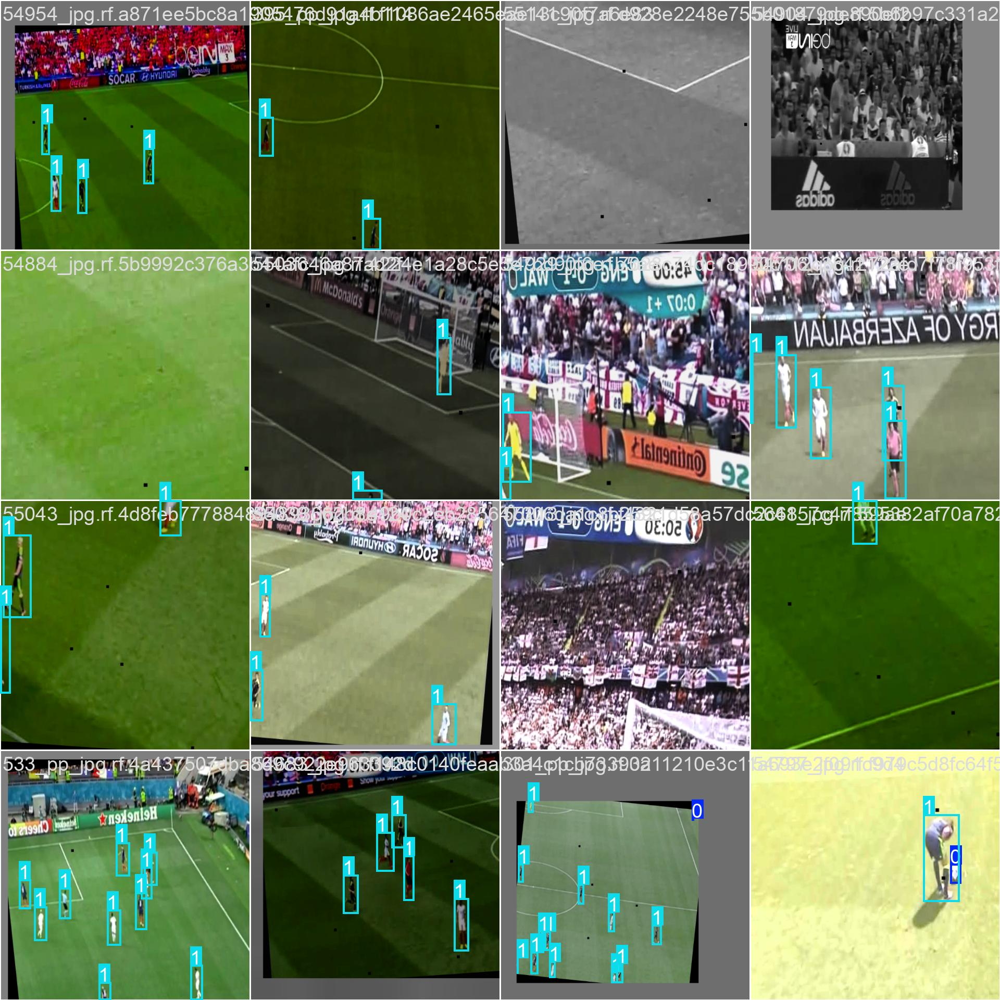

In [ ]:
### TRAINING Batches

t0 = Image.open('/kaggle/working/runs/detect/train/train_batch0.jpg')
t0

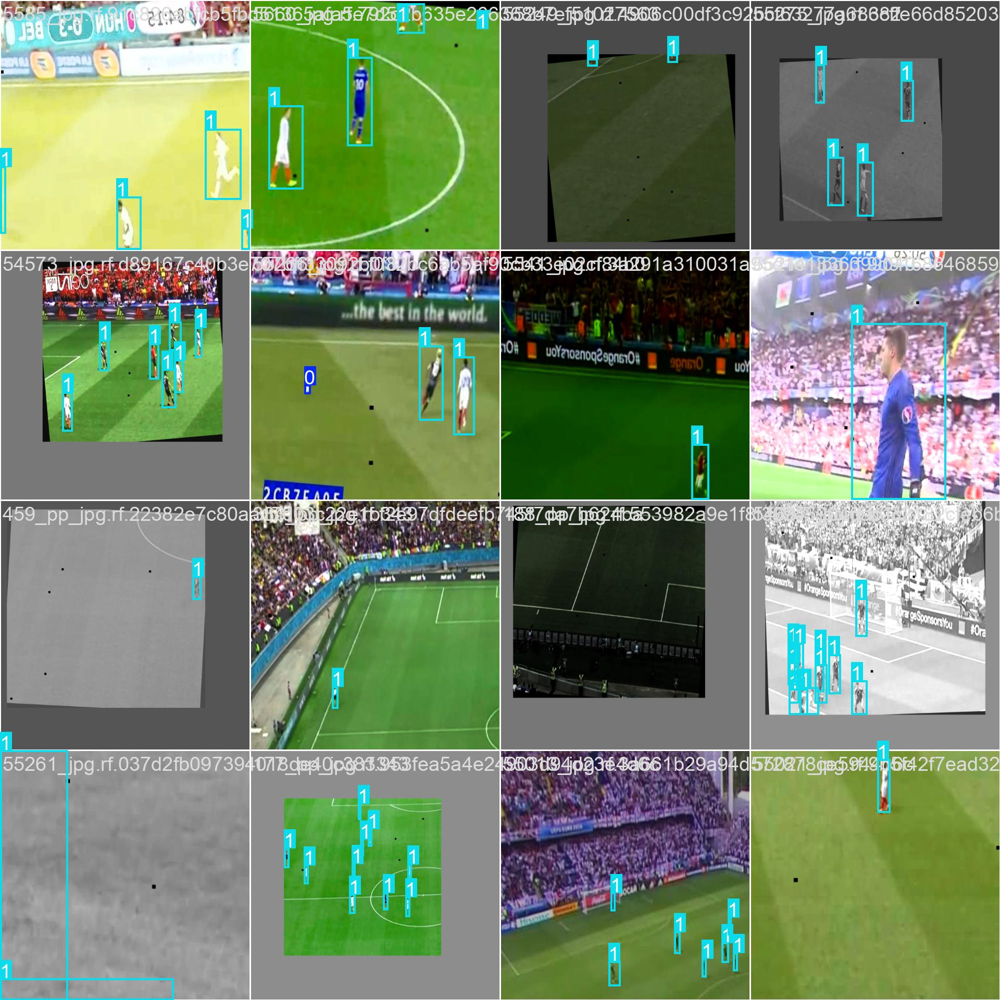

In [ ]:

t1 = Image.open('/kaggle/working/runs/detect/train/train_batch1.jpg')
t1

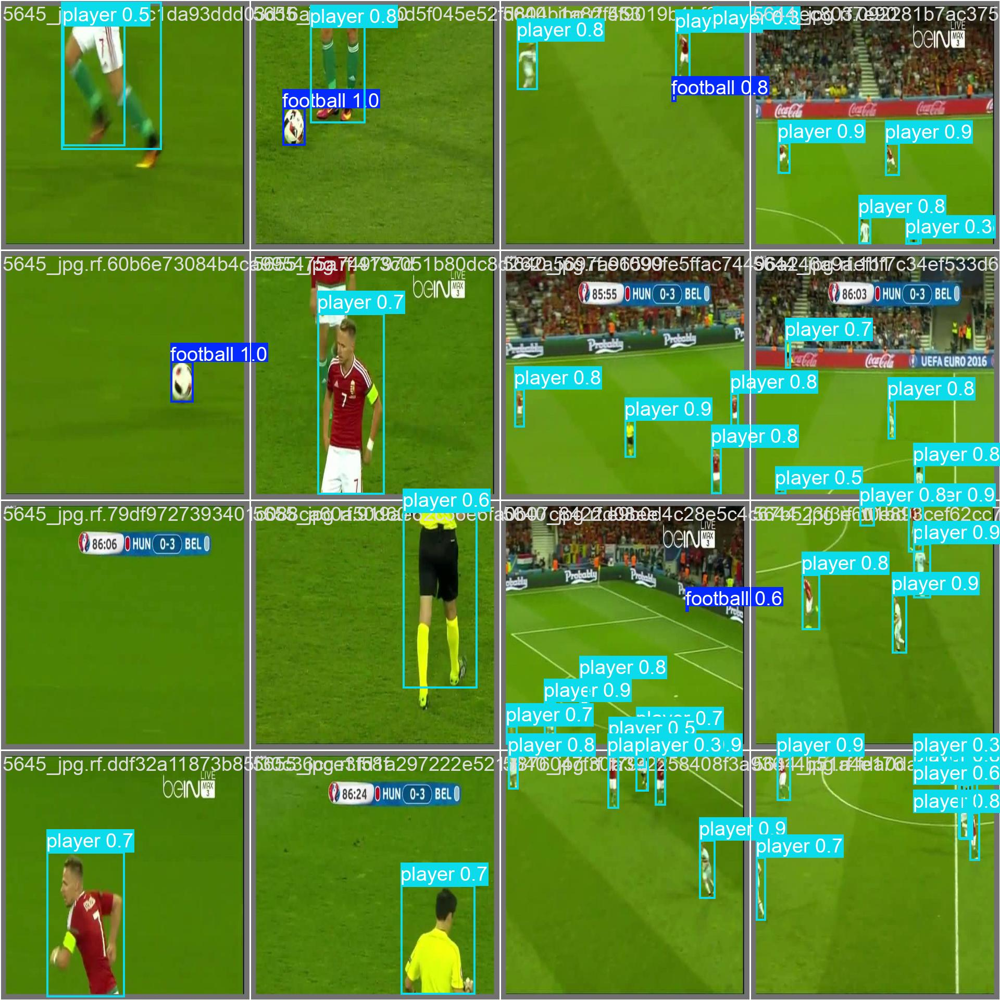

In [ ]:
### VALIDATION Batches

v0 = Image.open('/kaggle/working/runs/detect/train/val_batch0_pred.jpg')
v0

We see already that there are not many footballs in the training set. More will be said about this later.

### Training Results

We get a good mAP50 for the player class, but the one of the football class is not satisfactory at all. This can be easily explained by the confusion matrix.

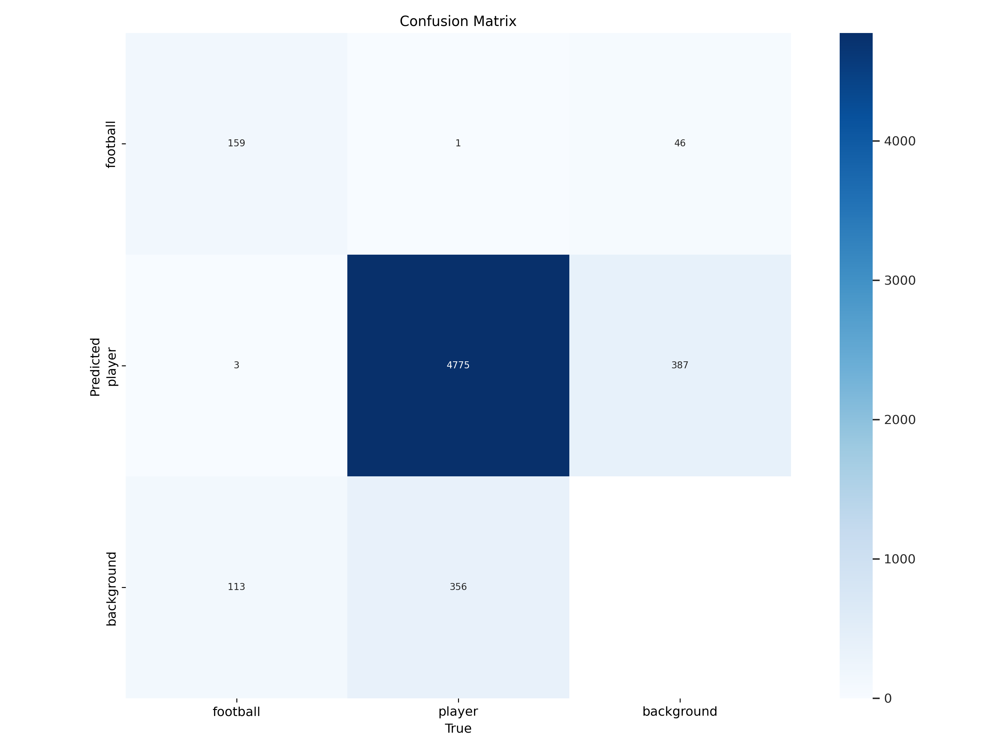

In [ ]:
### CONFUSION MATRIX

conf_mat = Image.open('/kaggle/working/runs/detect/train/confusion_matrix.png')
conf_mat

From the confusion matrix, we see already that the model does not detect well footballs. In fact, the model missed almost half of them. In particular, we see that for the football class, precision and recall are given by:
$$
\text{precision}=\frac{tp}{tp+fp}=\frac{159}{159 + 47} = 0.77184466019
$$
$$
\text{recall}=\frac{tp}{tp+fn}=\frac{159}{159 + 116} = 0.57818181818.
$$
On the other hand, the model seems to do a good job with the player class, where
$$
\text{precision}=\frac{tp}{tp+fp}=\frac{4775}{4775 + 390} = 0.92449177153
$$
$$
\text{recall}=\frac{tp}{tp+fn}=\frac{4775}{4775 + 390} = 0.930436477.
$$

The reason of the difference between the performances over the two classes is clear; the validation dataset contains more than 5000 football players, but less than 300 footballs. Other additional explanations could be that a football player is bigger and has a more recognizable shape.

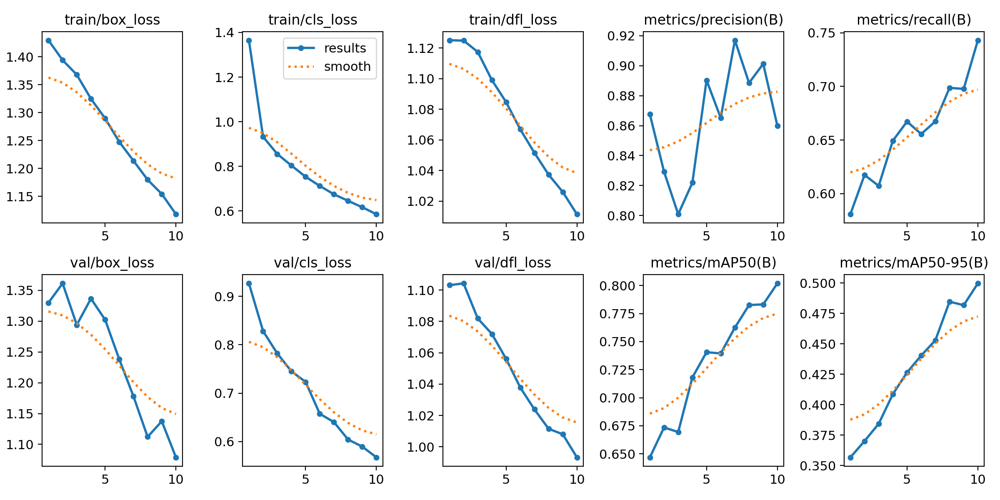

In [ ]:
### TRAINING RESULTS

res = Image.open('/kaggle/working/runs/detect/train/results.png')
res

Looking at all the metrics, we can presume that increasing the number of epochs could improve the preformance of the model. Hence, we try to re-train the model, this time with 15 epochs.

### New Training

In [ ]:
# Load a pre-trained model
model = YOLO('yolov8n.pt')

# Train the model
results = model.train(data='/kaggle/working/train_conf.yaml',
                        epochs=15)

New https://pypi.org/project/ultralytics/8.3.59 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/working/train_conf.yaml, epochs=15, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_f

train: Scanning /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/train/labels... 10308 images, 623 backgrounds, 0 corrupt: 100%|██████████| 10308/10308 [00:13<00:00, 774.32it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/valid/labels... 972 images, 30 backgrounds, 0 corrupt: 100%|██████████| 972/972 [00:01<00:00, 656.74it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      2.37G      1.433      1.292      1.109         22        640: 100%|██████████| 645/645 [02:32<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.95it/s]


                   all        972       5407      0.818      0.606      0.667      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      2.27G      1.408     0.9584      1.116         51        640: 100%|██████████| 645/645 [02:31<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.10it/s]


                   all        972       5407      0.795      0.597      0.655      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      2.22G      1.389     0.8962      1.107         28        640: 100%|██████████| 645/645 [02:30<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.90it/s]


                   all        972       5407      0.769       0.61      0.667      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      2.22G      1.362     0.8551      1.096         25        640: 100%|██████████| 645/645 [02:30<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.89it/s]


                   all        972       5407       0.84      0.644      0.715      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      2.25G      1.329     0.8078      1.081         36        640: 100%|██████████| 645/645 [02:28<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.22it/s]


                   all        972       5407      0.887      0.646      0.718       0.41
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      2.22G       1.28     0.7432      1.083         23        640: 100%|██████████| 645/645 [02:24<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.03it/s]


                   all        972       5407      0.863      0.666      0.745      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      2.22G      1.252     0.7156      1.071         11        640: 100%|██████████| 645/645 [02:24<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.19it/s]

                   all        972       5407      0.904      0.639      0.742      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      2.25G      1.218     0.6816      1.057         18        640: 100%|██████████| 645/645 [02:23<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.12it/s]

                   all        972       5407      0.898      0.667      0.768      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      2.21G        1.2     0.6614      1.047          5        640: 100%|██████████| 645/645 [02:23<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.28it/s]

                   all        972       5407      0.912      0.692      0.768      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      2.22G      1.175     0.6364      1.036         13        640: 100%|██████████| 645/645 [02:24<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  3.99it/s]

                   all        972       5407      0.879       0.73      0.792      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      2.24G      1.157     0.6191      1.031         13        640: 100%|██████████| 645/645 [02:23<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.06it/s]

                   all        972       5407       0.91      0.697      0.776      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      2.22G      1.139     0.6062      1.022         15        640: 100%|██████████| 645/645 [02:23<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.12it/s]

                   all        972       5407       0.85      0.741      0.808      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      2.21G       1.12     0.5878      1.016         13        640: 100%|██████████| 645/645 [02:23<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.08it/s]

                   all        972       5407      0.892      0.714      0.798      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      2.22G      1.091     0.5681      1.004          9        640: 100%|██████████| 645/645 [02:23<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.10it/s]

                   all        972       5407      0.922      0.701      0.799      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      2.22G      1.074     0.5532     0.9965         11        640: 100%|██████████| 645/645 [02:26<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.04it/s]

                   all        972       5407      0.893      0.718      0.803      0.511



15 epochs completed in 0.649 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:10<00:00,  2.98it/s]


                   all        972       5407      0.893      0.717      0.803      0.512
              football        241        275      0.855      0.513      0.657      0.349
                player        936       5132      0.931       0.92       0.95      0.675
Speed: 0.2ms preprocess, 2.2ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/train2


### New Training Result

We see already that both the mAP50 and the mAP50-95 metrics have increased, but very slightly.

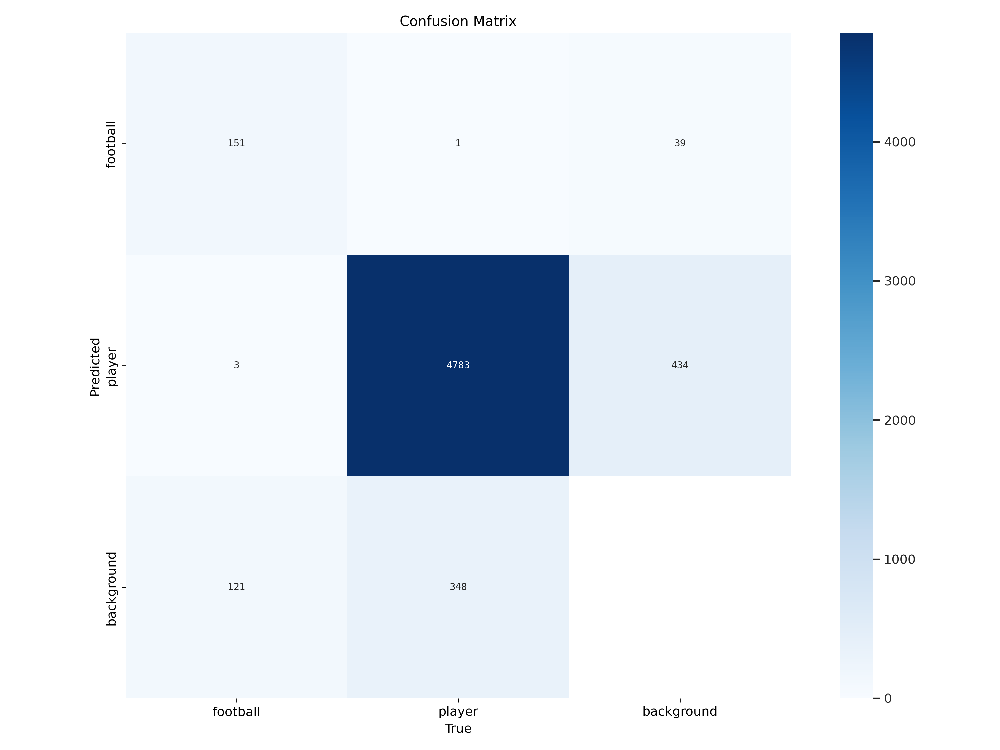

In [ ]:
### CONFUSION MATRIX

conf_mat = Image.open('/kaggle/working/runs/detect/train2/confusion_matrix.png')
conf_mat

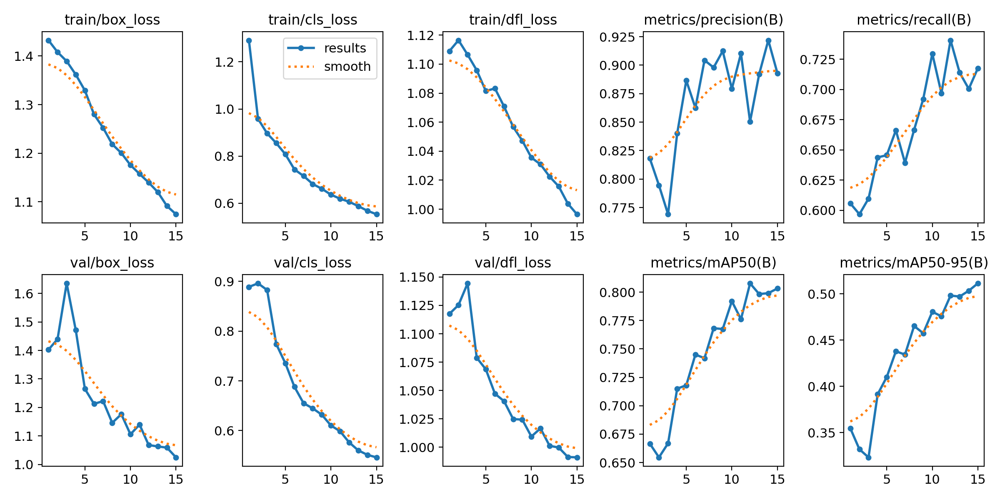

In [ ]:
### TRAINING RESULTS

res = Image.open('/kaggle/working/runs/detect/train2/results.png')
res

It is not worth it to increase the number of epochs anymore. It is now time to try the model prediction over the test set.

## INFERENCE

In [ ]:
######### LOADING BEST MODEL:
model = YOLO('/kaggle/working/runs/detect/train2/weights/best.pt')

# Define Path for the Test Directory
test_pth = '/kaggle/input/football-player-detection-yolov8/football_players_detection/football_players_detection/test'
img_names = os.listdir(test_pth + '/images/')


Next, we test the trained model over a few different images taken from the test set.


0: 640x640 1 player, 8.5ms
Speed: 3.3ms preprocess, 8.5ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


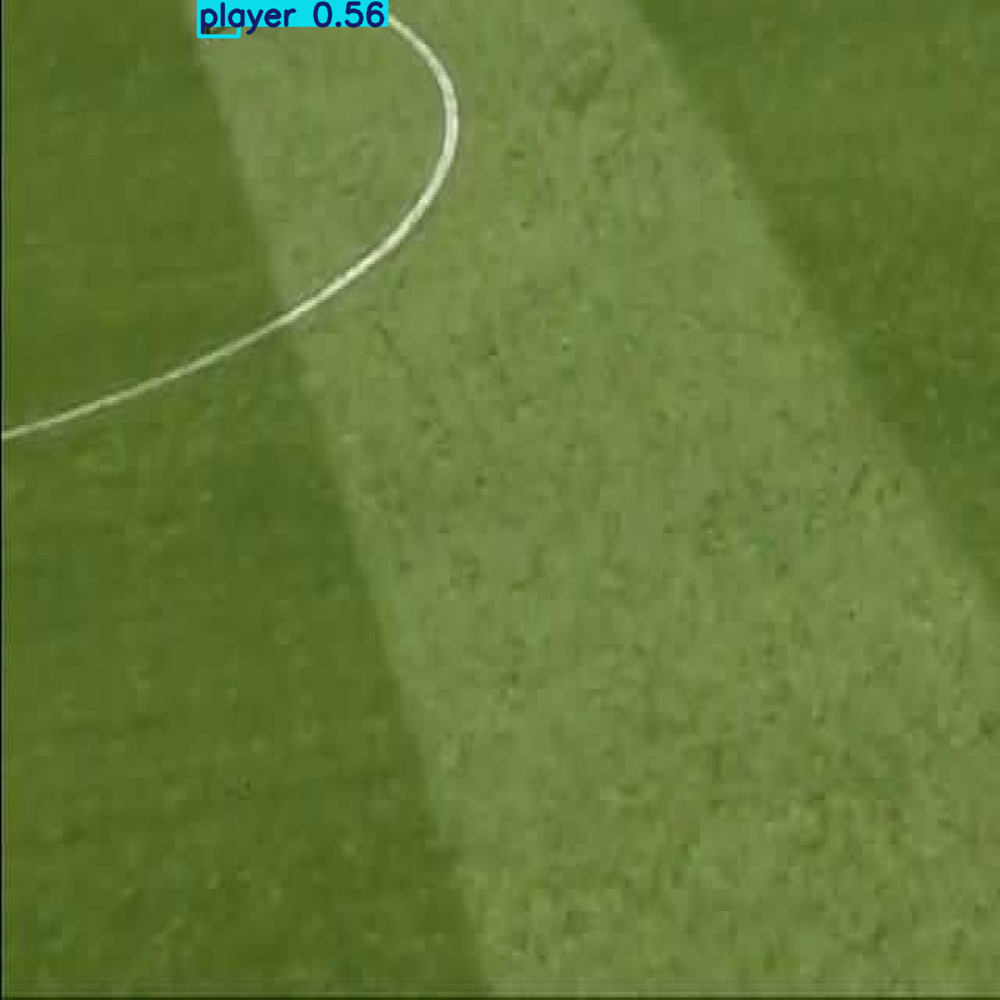


0: 640x640 2 players, 7.6ms
Speed: 2.9ms preprocess, 7.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


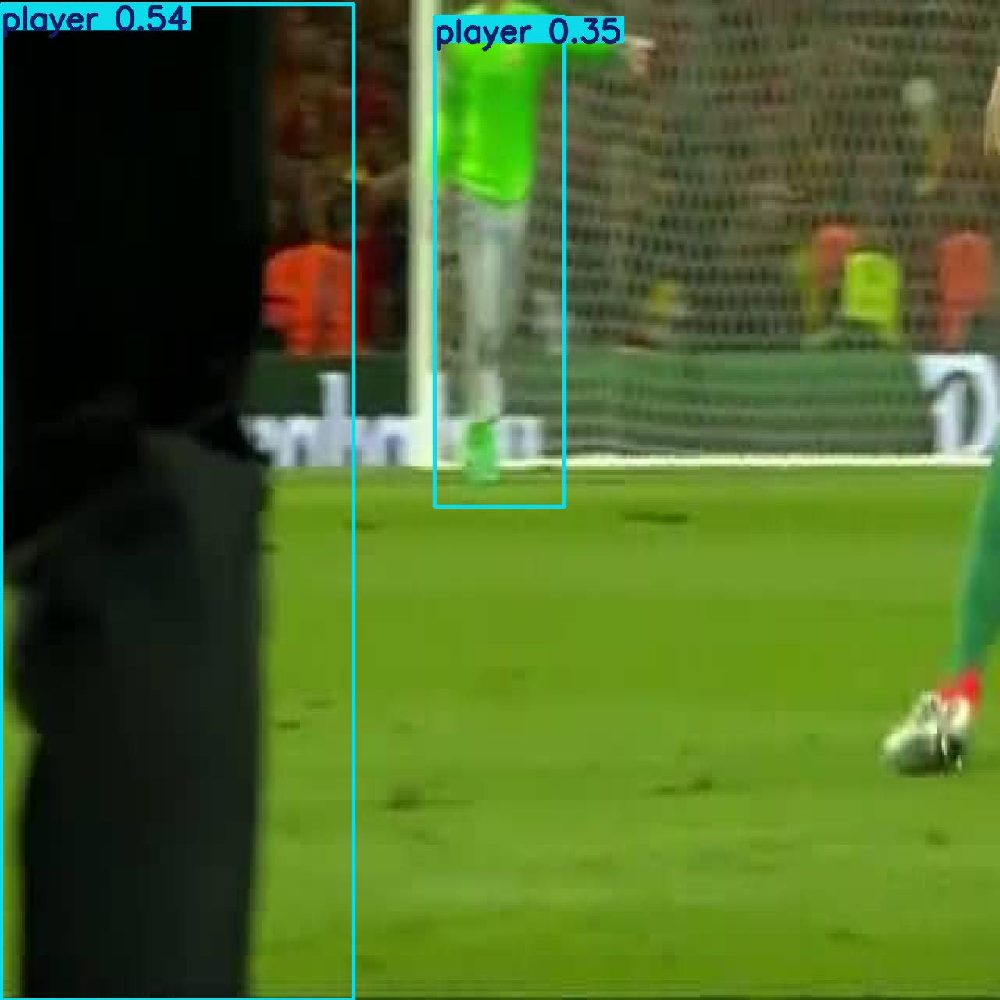


0: 640x640 1 football, 7 players, 7.7ms
Speed: 2.8ms preprocess, 7.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


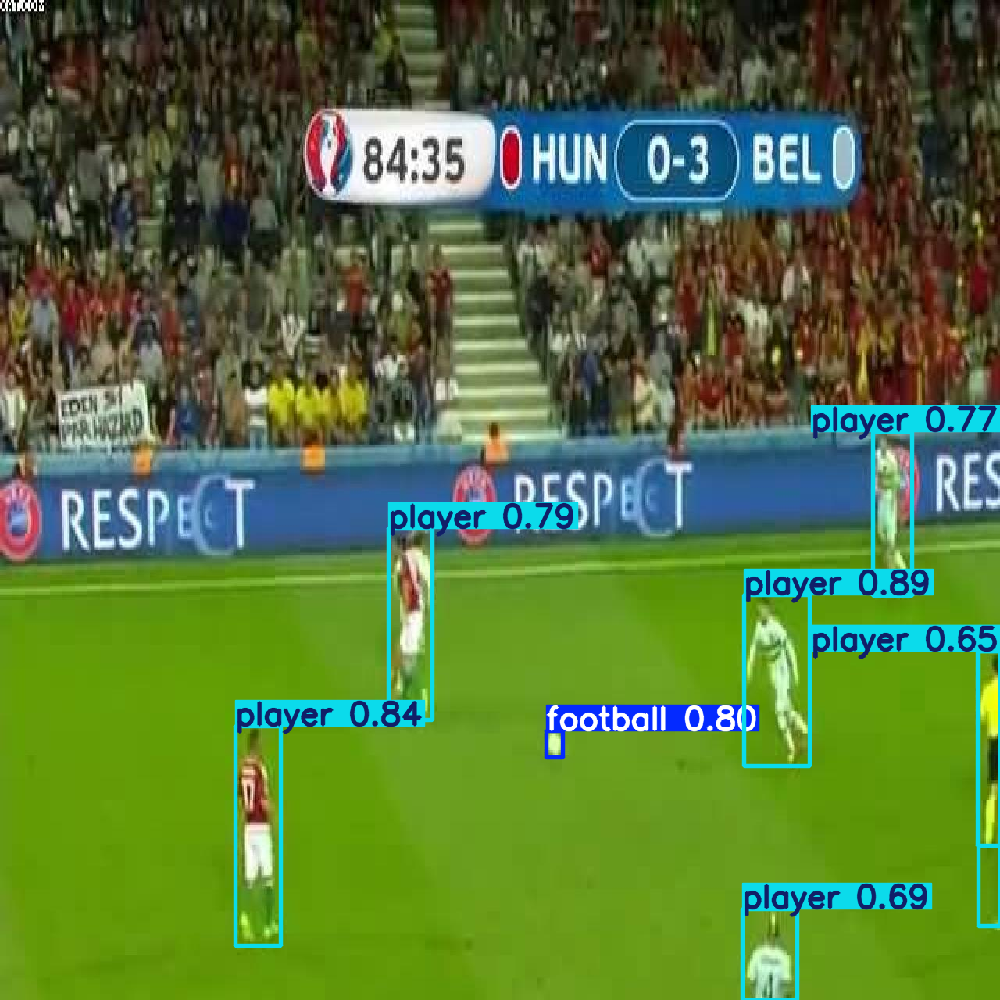


0: 640x640 5 players, 7.5ms
Speed: 2.9ms preprocess, 7.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


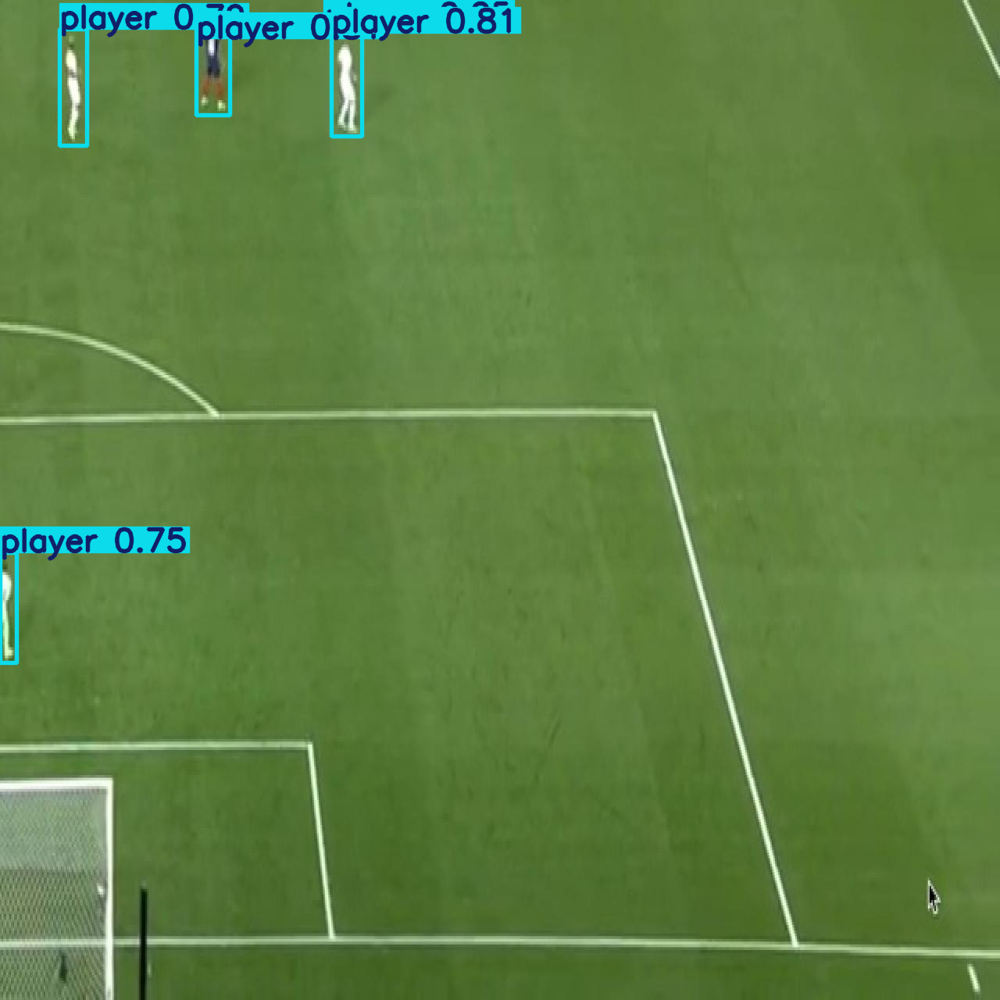


0: 640x640 7 players, 7.5ms
Speed: 3.0ms preprocess, 7.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


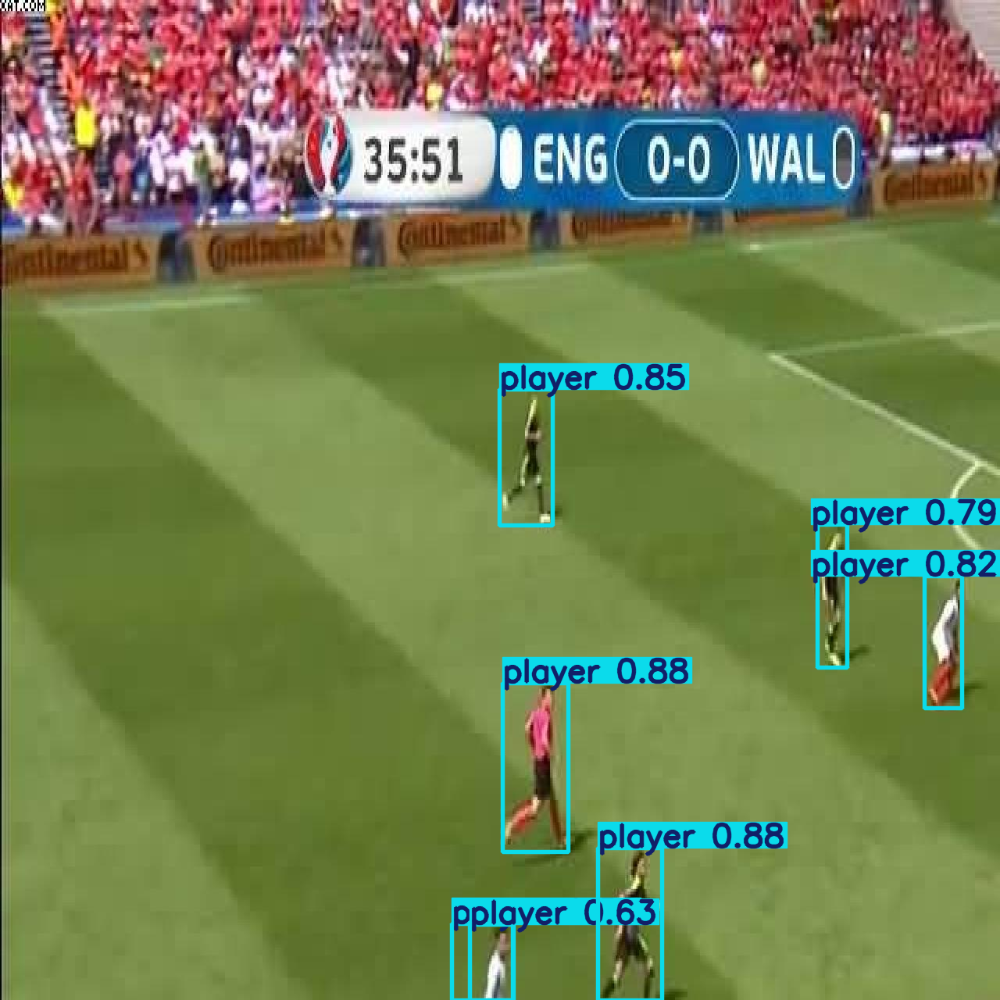

In [ ]:
# SET NUMBER OF IMAGES TO PLOT
number = 5

for i in range(number):

        # GETTING RANDOM IMAGE
        idx       = np.random.randint(0,len(img_names))
        imgname = test_pth + '/images/' + img_names[idx]
        img = Image.open(imgname)

        ### INFERENCE
        results = model.predict(img)
        results[0].show()


The inference results for the player detection are all in all satisfactory. One could argue that the model does not distinguish between players and referees, but this issue was already there in the training set. Developing a model capable of making this distinction would be highly challenging, as identifying referees would require additional context, such as recognizing uniform colors.

On the other hand, we see once again that also in the test set there are not enough footballs.